<a href="https://colab.research.google.com/github/YasmimCarvalhos/Train_Melanoma/blob/main/DetectorNonMelanoma.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#YOLOv8 Detection on a Custom Dataset

## Hardware accelerator

In [ ]:
!nvidia-smi

Fri Feb 27 13:11:55 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.82.07              Driver Version: 580.82.07      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   49C    P8             12W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Install YOLO

In [ ]:
# Pip install method (recommended)

!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics 8.4.18 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 43.4/112.6 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

## Dataset Roboflow

In [ ]:
!pip install roboflow

from IPython import display
display.clear_output()

In [ ]:
#INSERIR O DATASET AQUI

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="C8STPKZBlWXdI44Y0gwu")
project = rf.workspace("melanoma-9nudw").project("melanoma-acvbk-1ravu")
version = project.version(2)
dataset = version.download("yolov8-obb")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to melanoma-2 in yolov8-obb:: 100%|██████████| 5440/5440 [00:02<00:00, 2058.11it/s]


## Custom Training

In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolo11n.pt data={dataset.location}/data.yaml epochs=100 imgsz=640 batch=32

/content
Ultralytics 8.4.18 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/melanoma-2/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, p

## Results

In [ ]:
!ls {HOME}/runs/detect/train/

args.yaml			 results.csv	      val_batch0_labels.jpg
BoxF1_curve.png			 results.png	      val_batch0_pred.jpg
BoxP_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
BoxPR_curve.png			 train_batch1.jpg     val_batch1_pred.jpg
BoxR_curve.png			 train_batch2.jpg     val_batch2_labels.jpg
confusion_matrix_normalized.png  train_batch5400.jpg  val_batch2_pred.jpg
confusion_matrix.png		 train_batch5401.jpg  weights
labels.jpg			 train_batch5402.jpg


/content


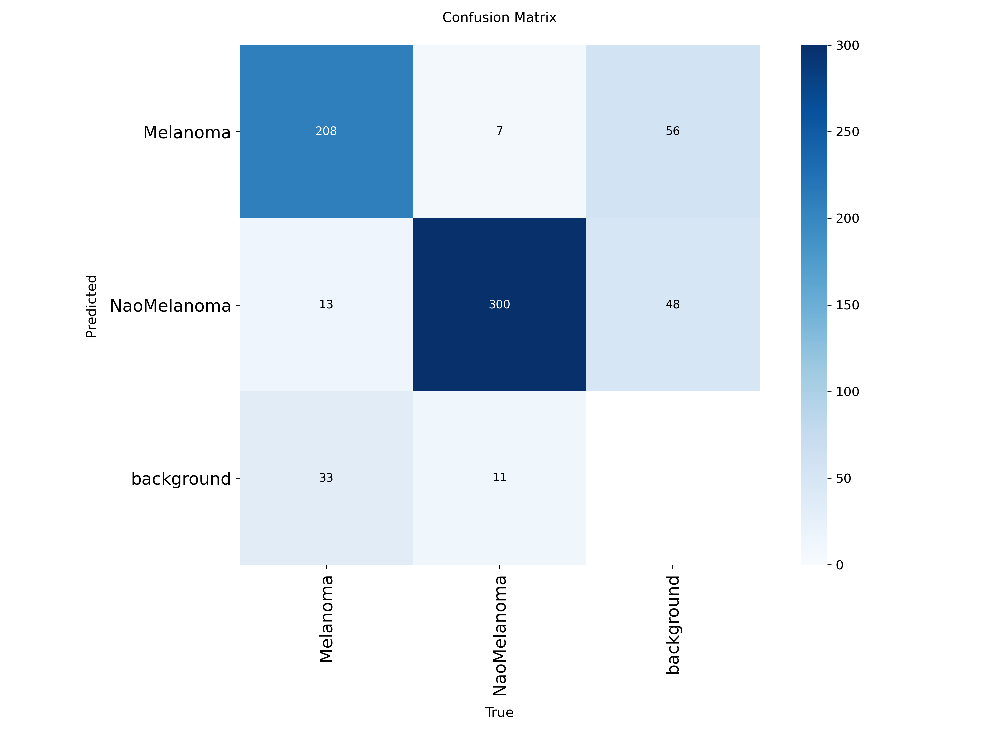

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

results_path = f'{HOME}/runs/detect/train/results.csv'
df = pd.read_csv(results_path)

df.columns  # use isso se quiser conferir os nomes das métricas

Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')

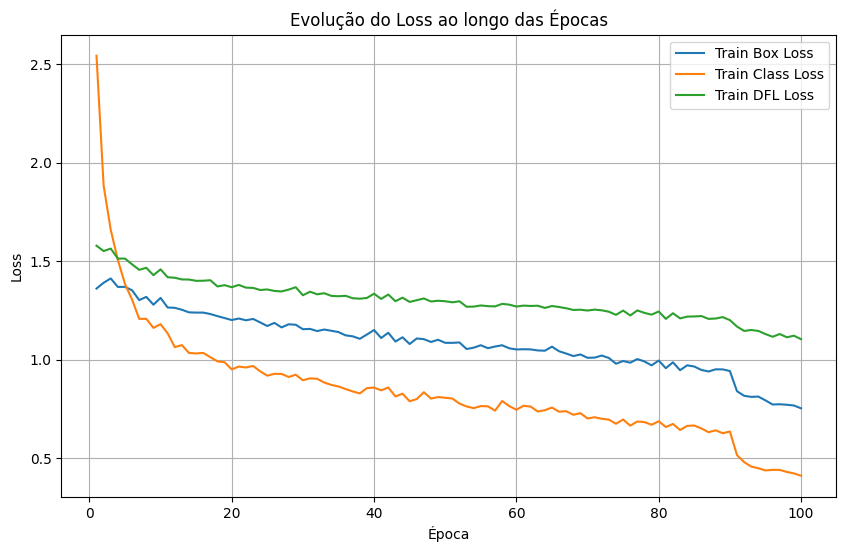

In [ ]:
plt.figure(figsize=(10, 6))

plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')

plt.plot(df['epoch'], df['train/cls_loss'], label='Train Class Loss')

plt.plot(df['epoch'], df['train/dfl_loss'], label='Train DFL Loss')


plt.title('Evolução do Loss ao longo das Épocas')
plt.xlabel('Época')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

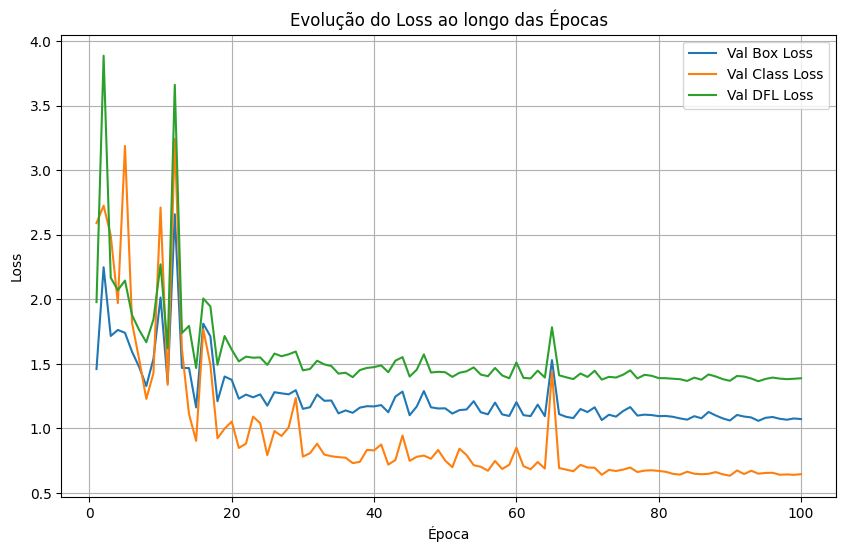

In [ ]:
plt.figure(figsize=(10, 6))

plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss')

plt.plot(df['epoch'], df['val/cls_loss'], label='Val Class Loss')

plt.plot(df['epoch'], df['val/dfl_loss'], label='Val DFL Loss')

plt.title('Evolução do Loss ao longo das Épocas')
plt.xlabel('Época')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

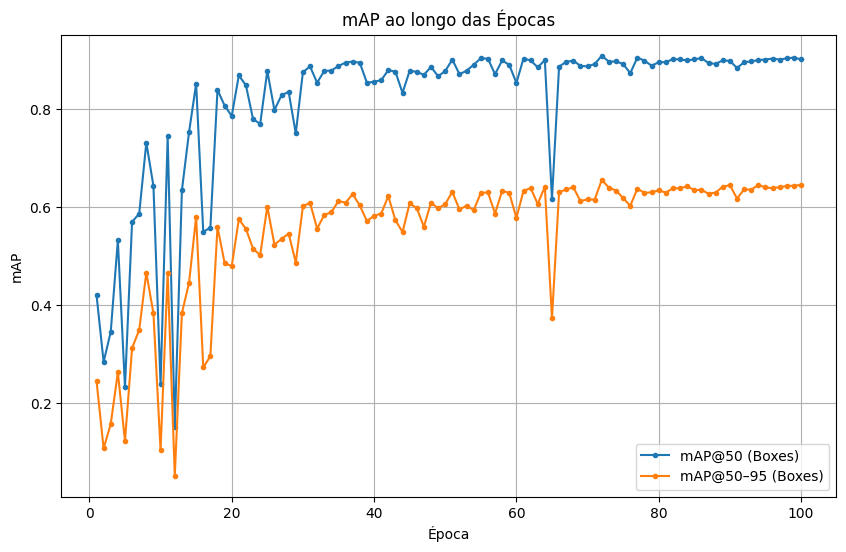

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(df['epoch'], df['metrics/mAP50(B)'], marker='.', label='mAP@50 (Boxes)')
plt.plot(df['epoch'], df['metrics/mAP50-95(B)'], marker='.', label='mAP@50–95 (Boxes)')

plt.title('mAP ao longo das Épocas')
plt.xlabel('Época')
plt.ylabel('mAP')
plt.grid(True)
plt.legend()
plt.show()

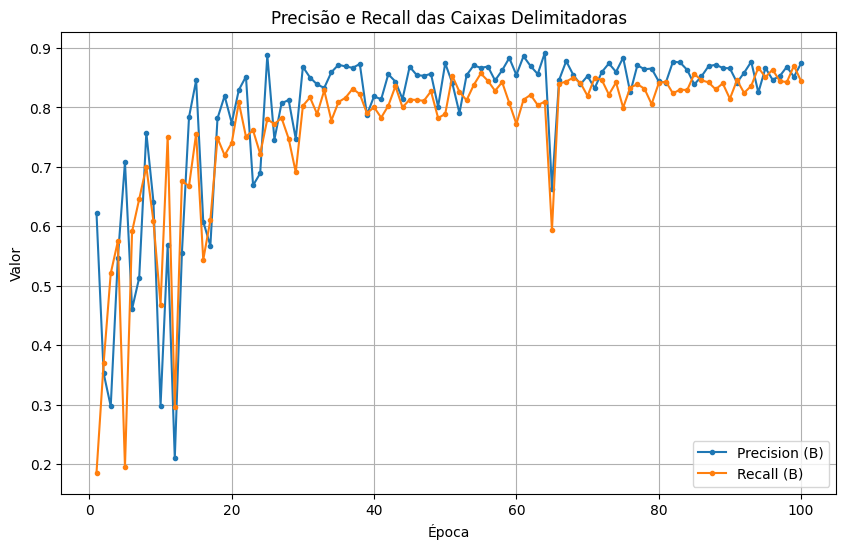

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(df['epoch'], df['metrics/precision(B)'], marker='.', label='Precision (B)')
plt.plot(df['epoch'], df['metrics/recall(B)'], marker='.', label='Recall (B)')

plt.title('Precisão e Recall das Caixas Delimitadoras')
plt.xlabel('Época')
plt.ylabel('Valor')
plt.grid(True)
plt.legend()
plt.show()


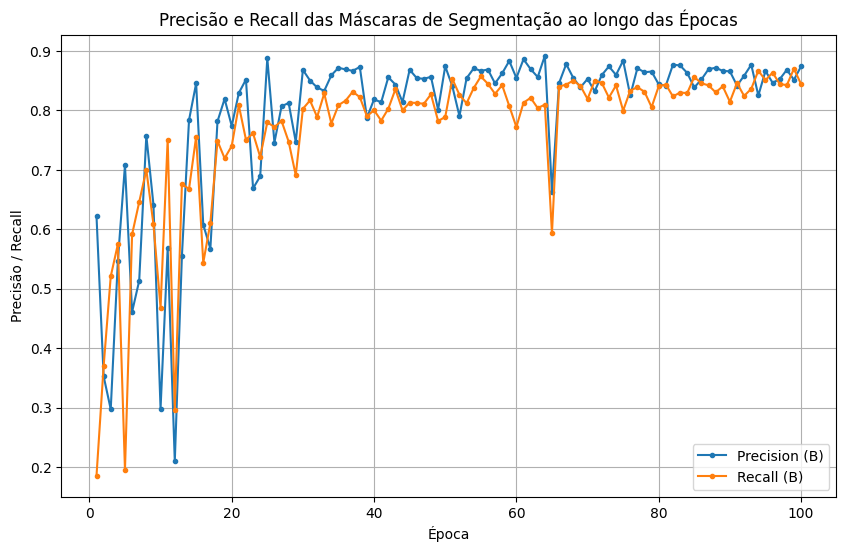

In [ ]:
plt.figure(figsize=(10, 6))

plt.plot(df['epoch'], df['metrics/precision(B)'],
         marker='.', linestyle='-', label='Precision (B)')

plt.plot(df['epoch'], df['metrics/recall(B)'],
         marker='.', linestyle='-', label='Recall (B)')

plt.title('Precisão e Recall das Máscaras de Segmentação ao longo das Épocas')
plt.xlabel('Época')
plt.ylabel('Precisão / Recall')
plt.grid(True)
plt.legend()
plt.show()


/content


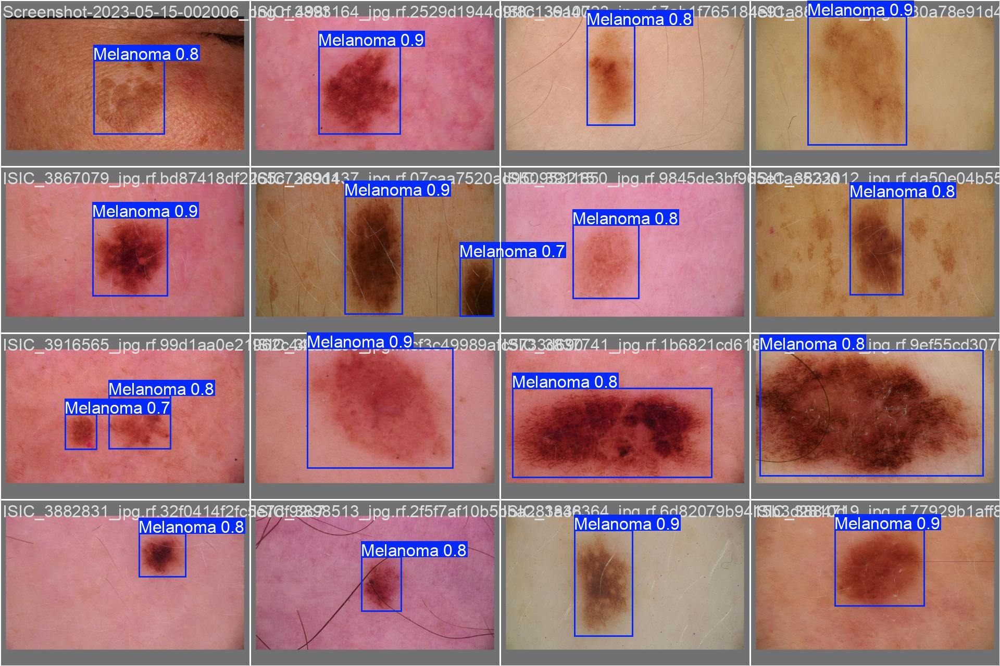

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

## Validate Custom Model

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics 8.4.18 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
YOLO11n summary (fused): 101 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1591.5±761.7 MB/s, size: 50.5 KB)
val: Scanning /content/melanoma-2/valid/labels.cache... 539 images, 13 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 539/539 98.3Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 34/34 2.6it/s 13.0s
                   all        539        572      0.867      0.842       0.91      0.656
              Melanoma        228        254      0.861       0.78      0.887       0.57
           NaoMelanoma        298        318      0.873      0.904      0.933      0.742
Speed: 1.3ms preprocess, 4.5ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to /content/runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


## Inference with Custom Model

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.5 source={dataset.location}/test/images save=true

/content
Ultralytics 8.4.18 🚀 Python-3.12.12 torch-2.10.0+cu128 CUDA:0 (Tesla T4, 14913MiB)
YOLO11n summary (fused): 101 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs

image 1/276 /content/melanoma-2/test/images/6059-lentigo-maligna-TS2__ProtectWyJQcm90ZWN0Il0_FocusFillWzI5NCwyMjIsIngiLDE5XQ_jpg.rf.47123542d7e64c991b67f5f64b56fb30.jpg: 640x640 1 Melanoma, 11.5ms
image 2/276 /content/melanoma-2/test/images/Angulated-lines-melanoma-TS-CG__ProtectWyJQcm90ZWN0Il0_FocusFillWzI5NCwyMjIsIngiLDE5XQ_jpg.rf.c49158c3de15101f0b012413f835c732.jpg: 640x640 (no detections), 7.9ms
image 3/276 /content/melanoma-2/test/images/C0167370-Melanoma_skin_cancer_spread_jpg.rf.833f57d26b5ed372a0c863c89d7436e2.jpg: 448x640 1 Melanoma, 50.3ms
image 4/276 /content/melanoma-2/test/images/C0254611-Lentigo_maligna_melanoma_jpg.rf.e74e9d611a2891ee16d4e4fe43845e94.jpg: 480x640 (no detections), 48.9ms
image 5/276 /content/melanoma-2/test/images/C0381678-Ulcerated_malignant_melanoma_jpg.rf.eda2a27b5424ddf2984cea1

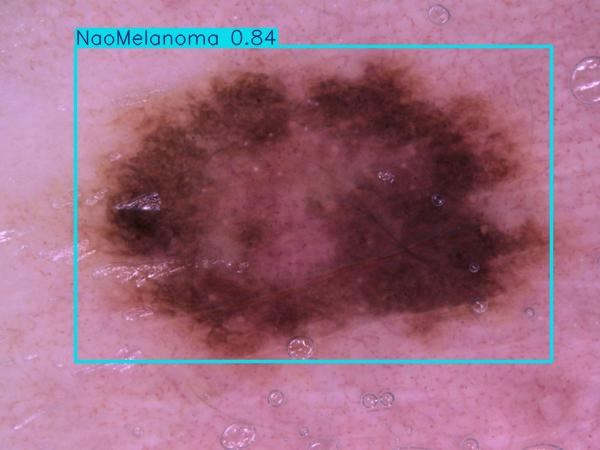

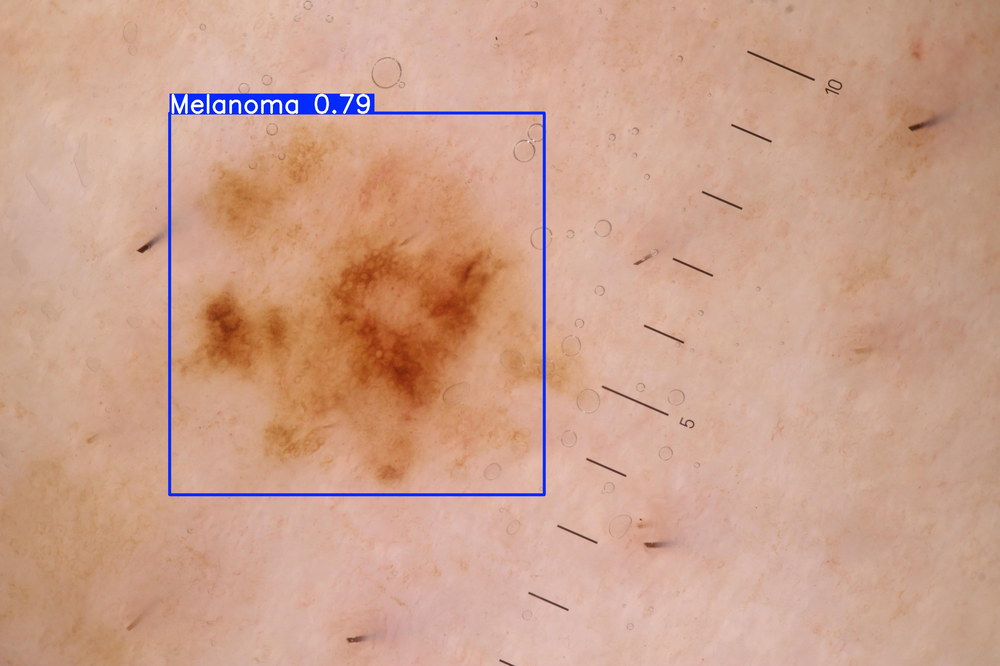

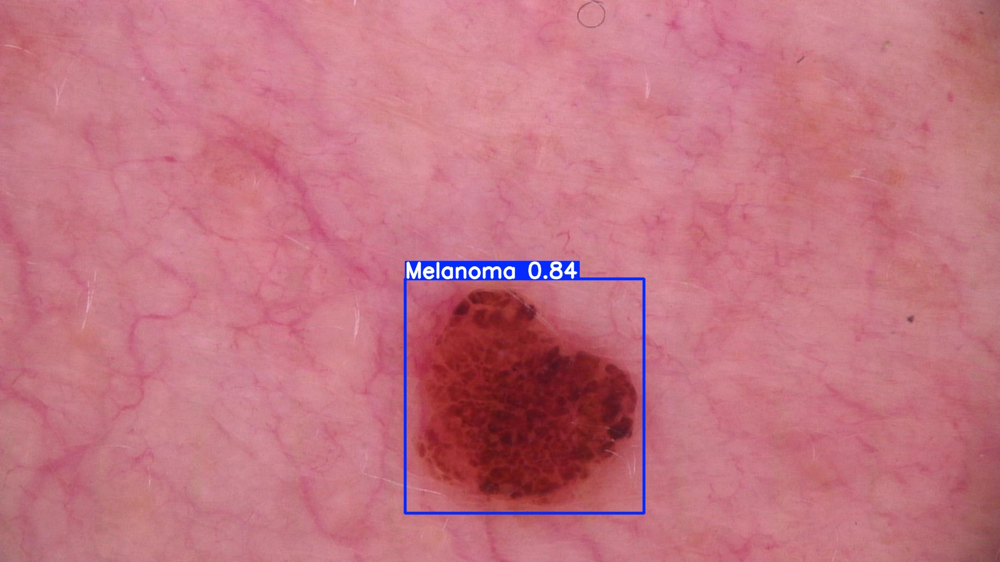

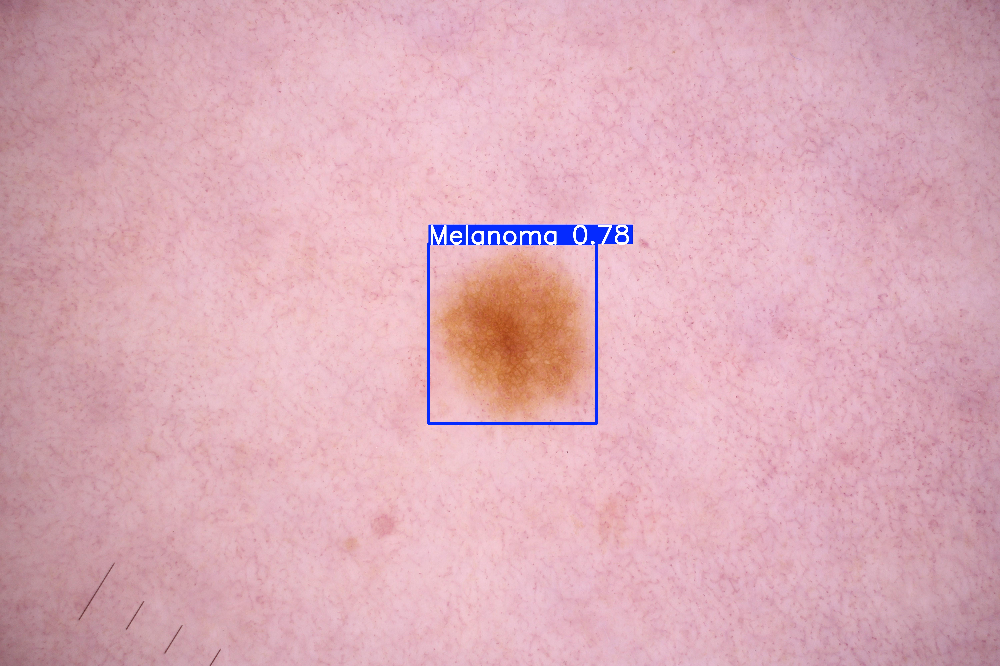

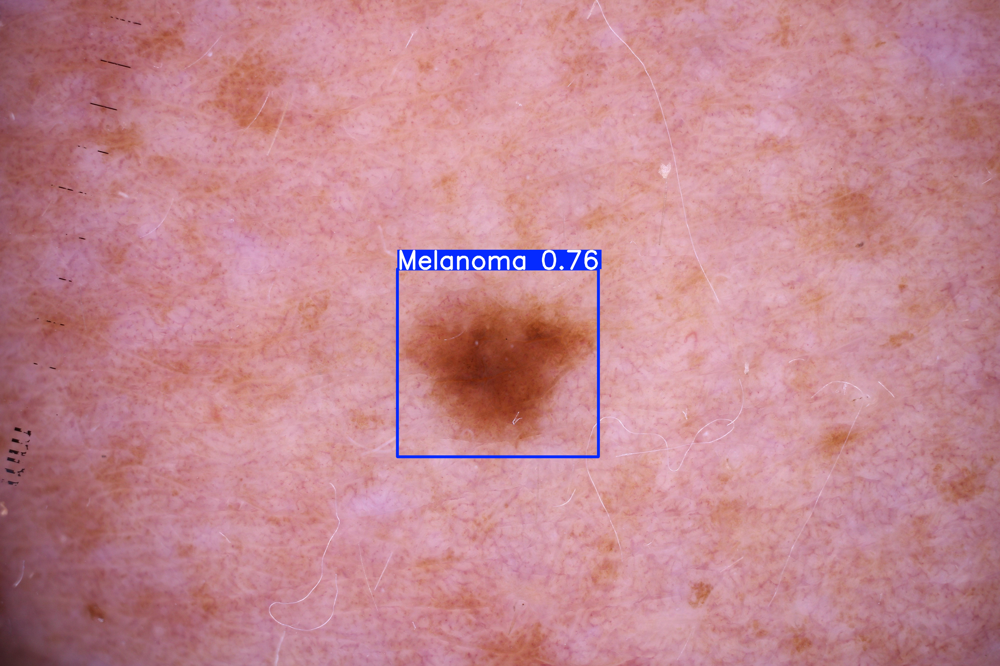

...

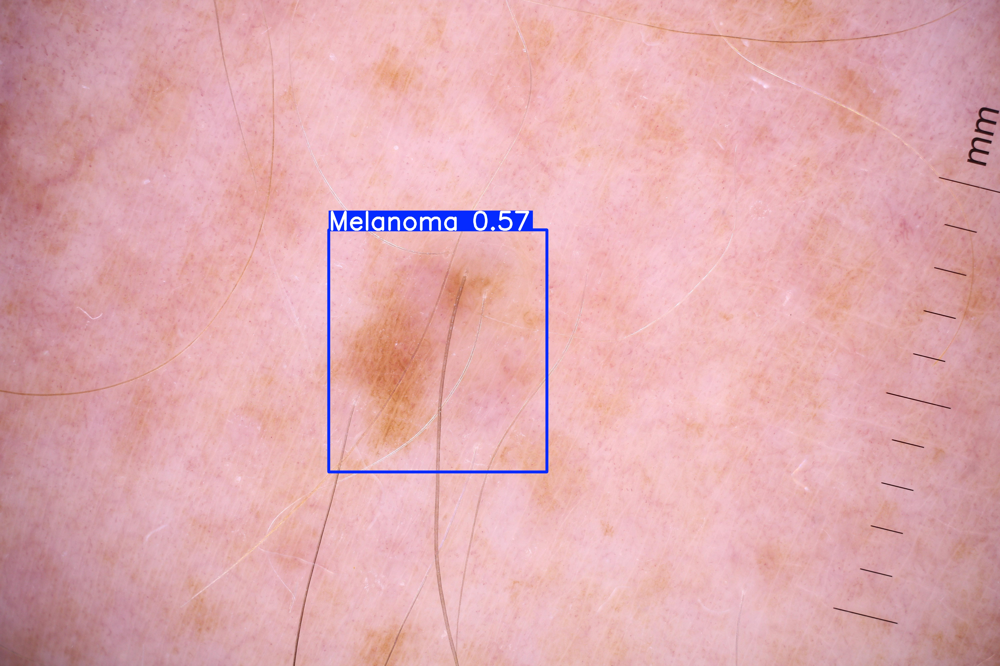

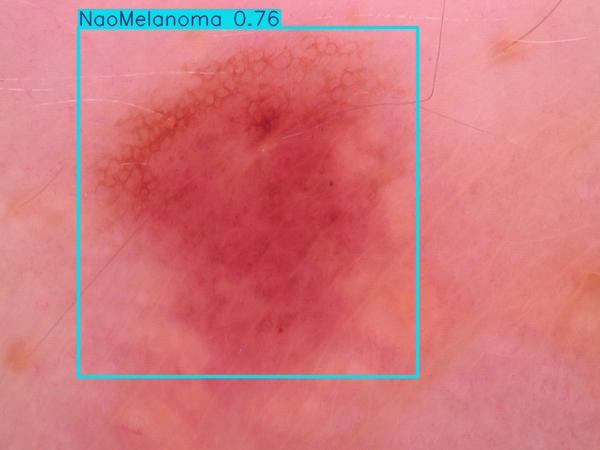

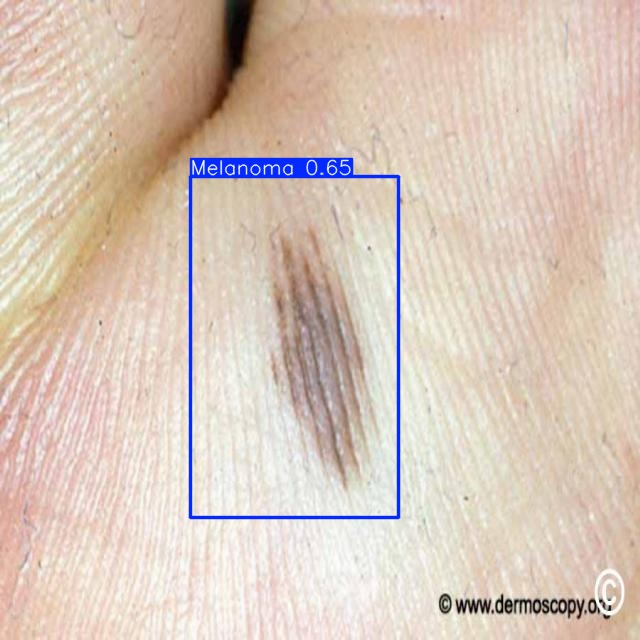

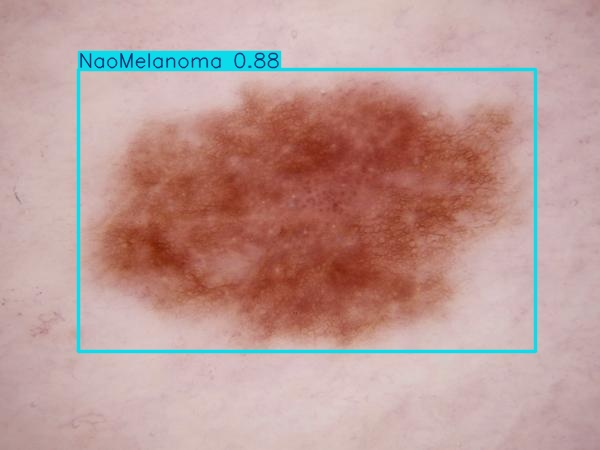

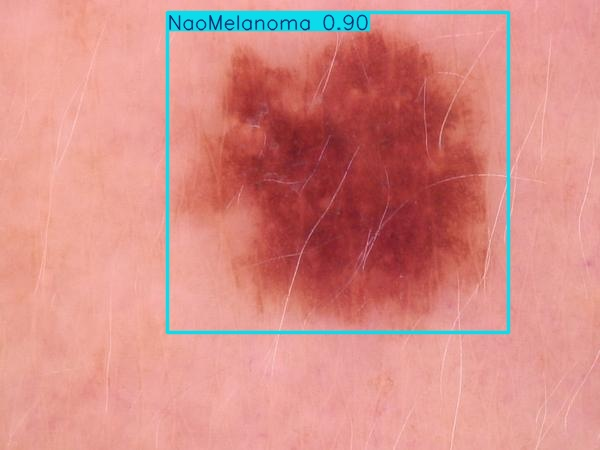

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg')[:30]:
      display(Image(filename=image_path, height=600))
      print("\n")